Load the data from Google Drive or any Path

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


**Dependencies**

In [ ]:
!pip install pyyaml==5.1
# This is the current pytorch version on Colab. Uncomment this if Colab changes its pytorch version
# !pip install torch==1.9.0+cu102 torchvision==0.10.0+cu102 -f https://download.pytorch.org/whl/torch_stable.html

# Install detectron2 that matches the above pytorch version
# See https://detectron2.readthedocs.io/tutorials/install.html for instructions
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu102/torch1.9/index.html
# exit(0)  # After installation, you need to "restart runtime" in Colab. This line can also restart runtime

In [ ]:
# check pytorch installation: 
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
assert torch.__version__.startswith("1.9")   # please manually install torch 1.9 if Colab changes its default version
from PIL import ImageFile
ImageFile.LOAD_TRUNCATED_IMAGES = True

In [ ]:
# Some basic setup and Imports:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

# Creating dataset

In [ ]:
DatasetCatalog.clear()

In [ ]:
from detectron2.structures import BoxMode

def get_data_dicts(img_dir,fname): #fname is the json file
    json_file = os.path.join(img_dir, fname)
    with open(json_file) as f:
        imgs_anns = json.load(f)

    dataset_dicts = []
    for i in range(len(imgs_anns["images"])):
      record = {}
      record["file_name"] = imgs_anns["images"][i]["file_path"]
      record["height"] = imgs_anns["images"][i]["height"]
      record["width"] = imgs_anns["images"][i]["width"]
      img_id = imgs_anns["images"][i]["id"]
      record["image_id"] = imgs_anns["images"][i]["id"]
      annotations = []
      annos = {}
      len_of_bbox_list = len(imgs_anns["annotations"][i]["bbox"])
      if len_of_bbox_list == 0:
        record["annotations"] = annotations
      else:
        annos["bbox"] = imgs_anns["annotations"][i]["bbox"]
        annos["bbox_mode"] = 1
        annos["category_id"] = imgs_anns["annotations"][i]["category_id"]
        annotations.append(annos)
        record["annotations"] = annotations

      dataset_dicts.append(record)
    return dataset_dicts

for d in ["train", "validation","test"]:
  if d == "train":
    DatasetCatalog.register("animals_" + d, lambda d=d: get_data_dicts("/content/drive/MyDrive/volunteer3/Training_Dataset",d+"2.json"))
    MetadataCatalog.get("animals_" + d).set(thing_classes=["empty","fox","skunk","rodent","bird","american crow","american black bear","chicken","virginia opossum","domestic cat","grey fox","rooster","donkey","raven","petrel_chick","goat","pig","shearwater","iguana","cat"])
  elif d== "test":
    DatasetCatalog.register("animals_"+d, lambda d=d: get_data_dicts("/content/drive/MyDrive/volunteer3/Testing_Dataset",d+"ing.json"))
    MetadataCatalog.get("animals_" + d).set(thing_classes=["empty","fox","skunk","rodent","bird","american crow","american black bear","chicken","virginia opossum","domestic cat","grey fox","rooster","donkey","raven","petrel_chick","goat","pig","shearwater","iguana","cat"])
  else:
    DatasetCatalog.register("animals_" + d, lambda d=d: get_data_dicts("/content/drive/MyDrive/volunteer3/Validation_Dataset",d+"2.json"))
    MetadataCatalog.get("animals_" + d).set(thing_classes=["empty","fox","skunk","rodent","bird","american crow","american black bear","chicken","virginia opossum","domestic cat","grey fox","rooster","donkey","raven","petrel_chick","goat","pig","shearwater","iguana","cat"])

animal_metadata = MetadataCatalog.get("animal_train")

# Bulid Trainer

In [ ]:
from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator
class CocoTrainer(DefaultTrainer):
  @classmethod
  def build_evaluator(cls, cfg, dataset_name, output_folder=None):
    if output_folder is None:
            os.makedirs("/content/drive/MyDrive/volunteer3/output/", exist_ok=True) # replace with your own path where output should be stored
            output_folder = "/content/drive/MyDrive/volunteer3/output/"
    return COCOEvaluator(dataset_name, ("bbox",), False, output_folder)
 


# Training Procedure

In [ ]:
from detectron2.engine import DefaultTrainer

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_C4_1x.yaml")) # selects Faster RCNN model
cfg.OUTPUT_DIR = "/content/drive/MyDrive/volunteer3/validation/output/" #mention your output directory
cfg.DATASETS.TRAIN = ("animals_train",)
cfg.DATASETS.TEST = ("animals_validation",)
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_50_C4_1x.yaml")  # Let training initialize from model zoo #initialise with some pretrained weights
cfg.SOLVER.IMS_PER_BATCH = 16
cfg.SOLVER.BASE_LR = 0.00025  # pick a good LR
cfg.SOLVER.NUM_GPUS=1
single_iteration = cfg.SOLVER.NUM_GPUS * cfg.SOLVER.IMS_PER_BATCH
iterations_for_one_epoch = int(TOTAL_NUM_IMAGES / single_iteration)+1
cfg.SOLVER.MAX_ITER = iterations_for_one_epoch * 10    # 10 is the number of iterations, change if you want to
print("Epochs : {} , maxiters : {}".format(10,cfg.SOLVER.MAX_ITER))
cfg.SOLVER.STEPS = []        # do not decay learning rate
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 64   
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 20  # only has one class (ballon). (see https://detectron2.readthedocs.io/tutorials/datasets.html#update-the-config-for-new-datasets)
# NOTE: this config means the number of classes, but a few popular unofficial tutorials incorrect uses num_classes+1 here.
cfg.DATALOADER.FILTER_EMPTY_ANNOTATIONS=False
cfg.TEST.EVAL_PERIOD = 1000
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
# trainer = DefaultTrainer(cfg)
trainer = CocoTrainer(cfg) 
# MetadataCatalog.get("balloon_train").evaluator_type = evaluator
trainer.resume_or_load(resume=False)
trainer.train()

Epochs : 10 , maxiters : 6970
[09/17 07:40:49 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): ResNet(
    (stem): BasicStem(
      (conv1): Conv2d(
        3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
        (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
      )
    )
    (res2): Sequential(
      (0): BottleneckBlock(
        (shortcut): Conv2d(
          64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=256, eps=1e-05)
        )
        (conv1): Conv2d(
          64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
        (conv2): Conv2d(
          64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
        (conv3): Conv2d(
          64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(

Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 2048) in the checkpoint but (21, 2048) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (21,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 2048) in the checkpoint but (80, 2048) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (80,) in the model! You might want to double check if this is expected.
Some model parameters or buffers are not found in the checkpoint:
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias

[09/17 07:40:50 d2.engine.train_loop]: Starting training from iteration 0
[09/17 07:41:51 d2.utils.events]:  eta: 5:54:07  iter: 19  total_loss: 4.196  loss_cls: 3.139  loss_box_reg: 0.842  loss_rpn_cls: 0.1656  loss_rpn_loc: 0.06162  time: 3.1005  data_time: 1.0573  lr: 4.9953e-06  max_mem: 14298M
[09/17 07:42:51 d2.utils.events]:  eta: 5:50:25  iter: 39  total_loss: 4.081  loss_cls: 2.999  loss_box_reg: 0.825  loss_rpn_cls: 0.1564  loss_rpn_loc: 0.0673  time: 3.0388  data_time: 0.9427  lr: 9.9902e-06  max_mem: 14298M
[09/17 07:43:53 d2.utils.events]:  eta: 5:49:25  iter: 59  total_loss: 3.718  loss_cls: 2.693  loss_box_reg: 0.8218  loss_rpn_cls: 0.1525  loss_rpn_loc: 0.05365  time: 3.0651  data_time: 1.0730  lr: 1.4985e-05  max_mem: 14298M
[09/17 07:44:53 d2.utils.events]:  eta: 5:47:21  iter: 79  total_loss: 3.266  loss_cls: 2.263  loss_box_reg: 0.8241  loss_rpn_cls: 0.15  loss_rpn_loc: 0.06149  time: 3.0469  data_time: 0.9382  lr: 1.998e-05  max_mem: 14298M
[09/17 07:45:54 d2.utils

# Visualise the result

In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir /content/drive/MyDrive/volunteer3/validation/output/ #mention the output directory

<IPython.core.display.Javascript object>

## Inference & evaluation using the trained model




In [ ]:
# Inference should use the config with parameters that are used in training
# cfg now already contains everything we've set previously. We changed it a little bit for inference:
cfg = get_cfg()
cfg.OUTPUT_DIR = "/content/drive/MyDrive/volunteer3/validation/output/"
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_C4_1x.yaml"))


print(cfg.OUTPUT_DIR)
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set a custom testing threshold
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 20
predictor = DefaultPredictor(cfg)

# Check result of model on image

(1080, 1920, 3)


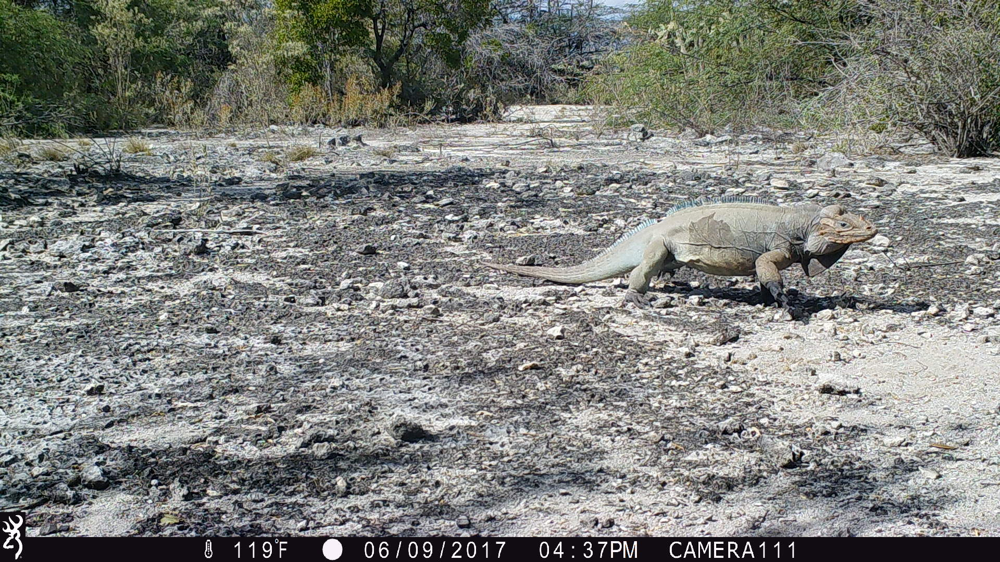

In [ ]:
from PIL import Image
from google.colab.patches import cv2_imshow
img = cv2.imread("/content/drive/MyDrive/ICVGIP_DS/Validation_dataset/Validation/validation_00000937.jpg") #pick any random image
cv2_imshow(img)
output = predictor(img)


In [ ]:
#print predictions
print(output["instances"].pred_classes)
print(output["instances"].pred_boxes)
print(output['instances'].scores)

tensor([18], device='cuda:0')
Boxes(tensor([[ 957.9031,  383.7841, 1699.6676,  588.9861]], device='cuda:0'))
tensor([0.9976], device='cuda:0')


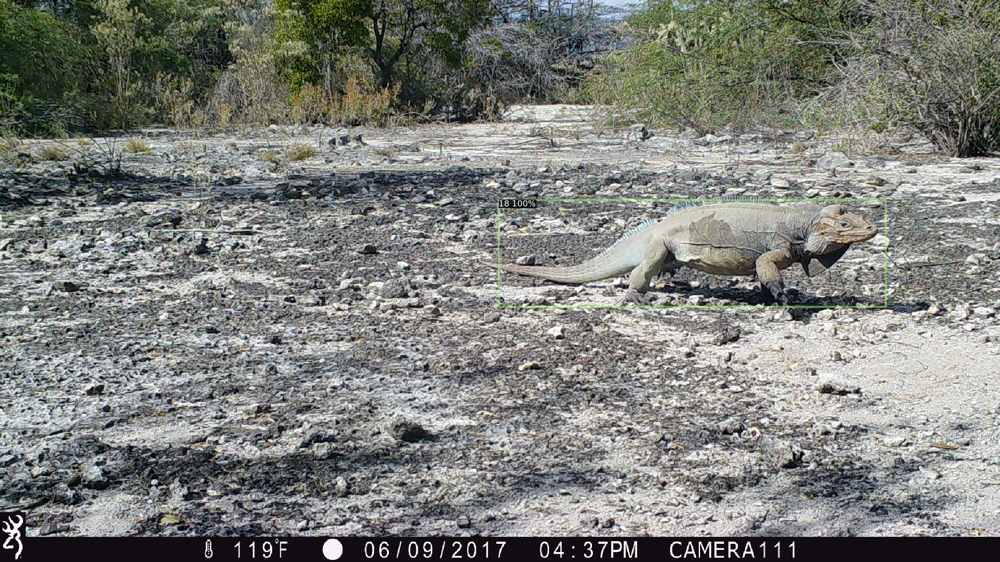

In [ ]:
# We can use `Visualizer` to draw the predictions on the image.
v = Visualizer(img[:, :, ::-1], metadata=animal_metadata, scale=1.2)
out = v.draw_instance_predictions(output["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

# Evaluate on validation set



In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("animals_validation", output_dir="./output")
val_loader = build_detection_test_loader(cfg, "animals_validation")
print(inference_on_dataset(predictor.model, val_loader, evaluator))


[09/22 03:59:52 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[09/22 03:59:52 d2.data.common]: Serializing 1588 elements to byte tensors and concatenating them all ...
[09/22 03:59:52 d2.data.common]: Serialized dataset takes 0.36 MiB
[09/22 03:59:52 d2.evaluation.evaluator]: Start inference on 1588 batches
[09/22 03:59:54 d2.evaluation.evaluator]: Inference done 11/1588. Dataloading: 0.0017 s/iter. Inference: 0.0686 s/iter. Eval: 0.0004 s/iter. Total: 0.0706 s/iter. ETA=0:01:51
[09/22 03:59:59 d2.evaluation.evaluator]: Inference done 76/1588. Dataloading: 0.0020 s/iter. Inference: 0.0745 s/iter. Eval: 0.0003 s/iter. Total: 0.0770 s/iter. ETA=0:01:56
[09/22 04:00:04 d2.evaluation.evaluator]: Inference done 116/1588. Dataloading: 0.0019 s/iter. Inference: 0.0922 s/iter. Eval: 0.0003 s/iter. Total: 0.0946 s/iter. ETA=0:02:19
[09/22 04:00:09 d2.evaluation.evaluator]: Infere